<a href="https://colab.research.google.com/github/abxda/UAurora-ECD/blob/main/Semana_1_Aurora_ECD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Se lee el archivo GeoPackage con los datos de población de Aguascalientes.  
2. Se corrigen los valores negativos de la variable de mujeres.  
3. Se renombran las columnas para mayor claridad.  
4. Se crea la nueva variable de hombres.  
5. Se guarda un nuevo archivo GeoPackage con los cambios.  
6. Se generan 4 mapas interactivos con **Folium** (total de población, total de mujeres, total de hombres y uno en blanco).  
7. Se hace un breve análisis estadístico elemental sobre la población total.

---

## **Instalación de librerías necesarias**

En Google Colab, antes de correr el código, instala las librerías necesarias (si aún no las tienes). Puedes ejecutar la siguiente celda:


---


In [2]:
#!pip install geopandas folium


## **1. Importación de librerías y lectura de datos**

In [3]:
import geopandas as gpd
import folium
from folium import Choropleth, GeoJson, GeoJsonTooltip
import numpy as np

# URL del archivo GeoPackage (manzanas urbanas de Aguascalientes)
url = "https://github.com/abxda/UAurora-ECD/raw/refs/heads/main/data/Poblacion-Aguascalientes.gpkg"

# Leer el archivo con GeoPandas
gdf = gpd.read_file(url)

# Mostrar las primeras filas para verificar la estructura
gdf.head()

,CVEGEO,POB1,POB42,geometry
0,0100100012649009,57,23,"MULTIPOLYGON (((-102.25094 21.86282, -102.2516..."
1,0100100011710048,2,-6,"MULTIPOLYGON (((-102.25305 21.86711, -102.2533..."
2,0100100012850008,220,80,"MULTIPOLYGON (((-102.25888 21.86328, -102.2580..."
3,0100100012850010,247,78,"MULTIPOLYGON (((-102.25829 21.86542, -102.2581..."
4,0100100012174039,0,0,"MULTIPOLYGON (((-102.26396 21.87771, -102.2637..."


<img src="https://miro.medium.com/v2/resize:fit:4800/format:webp/1*vhn_Rq1XXLKBvY6THp7SVg.jpeg"
     alt="Descripción de la imagen"
     style="width:100%; height:auto; display:block;">


**Explicación:**  
- `geopandas as gpd` nos permite manejar datos geoespaciales (shapefiles, GeoPackage, etc.) en formato DataFrame.  
- `folium` se utiliza para generar mapas interactivos.  
- `gdf` (GeoDataFrame) contiene las columnas: `CVEGEO`, `POB1` (población total) y `POB42` (población de mujeres), además de la geometría de cada manzana.

---

## **2. Limpieza y transformación de datos**

### 2.1 Reemplazo de valores negativos en la columna de mujeres

En el dataset, se menciona que:
- `-9` debe sustituirse por `0` (casos donde no se reporta población femenina).  
- `-6` debe sustituirse por `1` (casos donde posiblemente es un dato desconocido, pero lo ajustamos a 1).


In [4]:
# Reemplazar valores -9 y -6 en la columna POB42 (población de mujeres)
gdf['POB42'] = gdf['POB42'].replace({-9: 0, -6: 1})


### 2.2 Renombrar columnas

Renombraremos las columnas para que sean más descriptivas:
- `POB1` -> `POB_TOTAL`
- `POB42` -> `POB_MUJERES`


In [5]:
gdf = gdf.rename(columns={
    'POB1': 'POB_TOTAL',
    'POB42': 'POB_MUJERES'
})


### 2.3 Crear columna de hombres

Definimos la población de hombres como la diferencia entre población total y población de mujeres:


In [6]:
gdf['POB_HOMBRES'] = gdf['POB_TOTAL'] - gdf['POB_MUJERES']


## **3. Guardar un nuevo GeoPackage con las variables actualizadas**

Generamos un nuevo archivo GeoPackage que contenga los cambios:


In [7]:
output_filename = "Poblacion_Aguascalientes_Modificado.gpkg"
gdf.to_file(output_filename, driver="GPKG")
print(f"Archivo guardado como: {output_filename}")

Archivo guardado como: Poblacion_Aguascalientes_Modificado.gpkg



**Explicación:**  
- Con `to_file` y `driver="GPKG"`, se exporta el GeoDataFrame en formato GeoPackage.  
- Ahora `Poblacion_Aguascalientes_Modificado.gpkg` incluye los nombres de columna actualizados y la columna `POB_HOMBRES`.

---

## **4. Visualizaciones Interactivas con Folium**

Para crear mapas coropléticos (choropleth) que muestren la distribución de una variable sobre un mapa, utilizaremos **Folium**. Cada mapa se centrará en una variable distinta:

1. **Mapa de Población Total**  
2. **Mapa de Población de Mujeres**  
3. **Mapa de Población de Hombres**  
4. **Mapa de manzanas en color blanco** (sin datos)

### 4.1 Función de ayuda para crear un mapa base en Folium

Definimos una función que nos facilite la creación de un mapa centrado aproximadamente en Aguascalientes:

In [8]:
def crear_mapa_base(gdf, zoom_start=10):
    # Obtener el centro aproximado de los datos
    # gdf.to_crs(epsg=4326) asegura que la proyección sea WGS84
    gdf_wgs84 = gdf.to_crs(epsg=4326)
    centro = gdf_wgs84.geometry.unary_union.centroid
    m = folium.Map(location=[centro.y, centro.x], zoom_start=zoom_start)
    return m

**Nota:**  
- Convertimos a `epsg=4326` para que Folium (que usa coordenadas lat/long) pueda interpretar correctamente la geometría.

### 4.2 Mapa temático para una variable

Podemos reutilizar la misma estructura para cada variable. Observa cómo se define `columns` y `key_on`:


In [17]:
def mapa_coropleth(gdf, variable, nombre_leyenda):
    # Crear mapa base
    m = crear_mapa_base(gdf)

    # Convertir el GeoDataFrame a WGS84 para folium
    gdf_wgs84 = gdf.to_crs(epsg=4326)

    # Crear capa coroplética
    choropleth = Choropleth(
        geo_data=gdf_wgs84.__geo_interface__,
        data=gdf_wgs84,
        columns=['CVEGEO', variable],
        key_on='feature.properties.CVEGEO',
        fill_color='YlOrRd',
        fill_opacity=0.85,
        line_opacity=0.01,
        legend_name=nombre_leyenda
    ).add_to(m)

    # Añadir popups interactivos
    geojson_layer = folium.GeoJson(
        gdf_wgs84,
        style_function=lambda x: {'fillOpacity': 0, 'color': 'transparent'},
        tooltip=folium.GeoJsonTooltip(fields=['CVEGEO', variable],
                                    aliases=['CVE GEO: ', f'{variable}: '],
                                    sticky=True),
        popup=folium.GeoJsonPopup(fields=['CVEGEO', variable],
                                aliases=['CVE GEO: ', f'{variable}: '],
                                localize=True)
    ).add_to(m)

    return m

### 4.3 Generar los 3 mapas (Población Total, Mujeres y Hombres)

In [18]:
# Mapa 1: Población Total
mapa_total = mapa_coropleth(gdf, 'POB_TOTAL', 'Total de Población')
mapa_total

<ipython-input-8-08985490fd47>:5: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centro = gdf_wgs84.geometry.unary_union.centroid



### 4.4 Mapa de manzanas en color blanco

Para mostrar simplemente la geometría de las manzanas sin asociarles un valor, creamos un mapa donde todas se pinten de blanco:


In [19]:
def mapa_blanco(gdf):
    m = crear_mapa_base(gdf)
    gdf_wgs84 = gdf.to_crs(epsg=4326)

    # Agregar capa GeoJson con estilo en blanco
    GeoJson(
        gdf_wgs84.__geo_interface__,
        name="Manzanas en Blanco",
        style_function=lambda x: {
            'fillColor': 'white',
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': 1
        }
    ).add_to(m)

    return m

mapa_manzanas_blanco = mapa_blanco(gdf)
mapa_manzanas_blanco

<ipython-input-8-08985490fd47>:5: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centro = gdf_wgs84.geometry.unary_union.centroid


En este mapa no hay escala de colores ni leyenda; es simplemente la visualización de las manzanas.

---

## **5. Análisis Estadístico Elemental de la Población Total**

Por último, hacemos un análisis estadístico muy básico de la variable `POB_TOTAL` para ilustrar la idea de “parámetros poblacionales” (aunque aquí estamos analizando datos por manzana, se puede ejemplificar con la noción de “población” como sumatoria de todas las manzanas urbanas):


In [20]:
import pandas as pd

# Descriptivos de la población total
descriptivos = gdf['POB_TOTAL'].describe()
print("Estadísticos descriptivos de la Población Total:")
print(descriptivos)

# Suma total de la población
suma_poblacion = gdf['POB_TOTAL'].sum()
print(f"\nSuma total de la población en todas las manzanas: {suma_poblacion}")

# Media (promedio) de población por manzana
media_poblacion = gdf['POB_TOTAL'].mean()
print(f"Media de población por manzana: {media_poblacion:.2f}")

# Mediana de población por manzana
mediana_poblacion = gdf['POB_TOTAL'].median()
print(f"Mediana de población por manzana: {mediana_poblacion}")

Estadísticos descriptivos de la Población Total:
count    12640.000000
mean        75.758623
std         71.813337
min          0.000000
25%         20.000000
50%         59.000000
75%        114.000000
max       1222.000000
Name: POB_TOTAL, dtype: float64

Suma total de la población en todas las manzanas: 957589
Media de población por manzana: 75.76
Mediana de población por manzana: 59.0



**Interpretación (ejemplo):**  
- La **suma total** representa cuántas personas hay en todas las manzanas urbanas incluidas en este archivo.  
- La **media** nos da un parámetro “promedio” de cuántas personas viven por manzana (aunque no es la media de individuos a nivel personal, sirve como un indicador).  
- La **mediana** nos indica el punto central de la distribución de población por manzana, útil cuando existen valores extremos.  

Estos valores pueden ayudarte a explicar la diferencia entre una medida de tendencia central y un parámetro global (por ejemplo, la suma total puede considerarse un “parámetro” de la población urbana de Aguascalientes en este contexto).

---

In [23]:
# Importación de bibliotecas necesarias
import geopandas as gpd  # Para trabajar con datos geoespaciales
import numpy as np       # Para cálculos matemáticos y manejo de números
import matplotlib.pyplot as plt  # Para crear visualizaciones gráficas

def calcular_tamano_muestra(gdf, margin_relativo=0.1, confidence=0.95):
    """
    Calcula el tamaño de muestra necesario para estimar la población total.

    Parámetros:
    gdf (GeoDataFrame): Datos geoespaciales con columna 'POB_TOTAL'
    margin_relativo (float): Error relativo máximo permitido (10% por defecto)
    confidence (float): Nivel de confianza deseado (95% por defecto)

    Retorna:
    int: Tamaño de muestra requerido, redondeado hacia arriba
    """
    # 1. Determinar parámetros básicos de la población
    N = len(gdf)  # Total de elementos en la población (ej. número de manzanas)
    mu = gdf['POB_TOTAL'].mean()  # Promedio de población por manzana
    sigma = gdf['POB_TOTAL'].std()  # Desviación estándar de la población

    # 2. Configurar parámetros estadísticos
    z = 1.96  # Valor z para 95% de confianza (distribución normal estándar)
    E = margin_relativo * mu  # Error absoluto máximo permitido

    # 3. Calcular tamaño muestral inicial (población infinita)
    n0 = (z**2 * sigma**2) / (E**2)  # Fórmula básica de tamaño muestral

    # 4. Aplicar corrección para población finita
    n = (N * n0) / (n0 + N - 1)  # Ajuste cuando la muestra es significativa respecto a la población

    # 5. Redondear resultado y asegurar que sea entero
    return int(np.ceil(n))  # np.ceil asegura redondeo hacia arriba

def generar_muestras_y_estimar(gdf, num_muestras=5, sample_size=None):
    """
    Genera muestras aleatorias y visualiza resultados.

    Parámetros:
    gdf (GeoDataFrame): Datos completos con geometrías y población
    num_muestras (int): Número de muestras a generar y visualizar
    sample_size (int/None): Tamaño de muestra a usar (calculado si es None)
    """
    # 1. Configurar parámetros básicos
    N = len(gdf)  # Total de elementos en la población

    # 2. Determinar tamaño de muestra si no se especifica
    if sample_size is None:
        sample_size = calcular_tamano_muestra(gdf)
    print(f"Tamaño de muestra calculado: {sample_size} (de {N} elementos totales)")

    # 3. Preparar figura para visualización
    # Crear una fila de subplots usando matplotlib
    fig, axs = plt.subplots(1, num_muestras, figsize=(20, 4))

    # 4. Generar y visualizar cada muestra
    for i in range(num_muestras):
        # 4.1 Seleccionar muestra aleatoria
        # random_state=i permite reproducibilidad (misma semilla para cada iteración)
        muestra = gdf.sample(n=sample_size, random_state=i)

        # 4.2 Calcular estimación poblacional
        # Media de la muestra multiplicada por el total de elementos
        estimacion = muestra['POB_TOTAL'].mean() * N

        # 4.3 Visualizar resultados
        # Dibujar todas las manzanas en gris (fondo)
        gdf.plot(ax=axs[i], color='lightgrey', edgecolor='white')

        # Resaltar muestra seleccionada con bordes rojos
        muestra.plot(ax=axs[i], facecolor="none", edgecolor='red', linewidth=1.5)

        # 4.4 Personalizar título del subplot
        # :, formatea números con separadores de miles
        axs[i].set_title(f"Muestra {i+1}\nEstimación: {int(estimacion):,}")
        axs[i].axis('off')  # Ocultar ejes para mejor presentación

    # 5. Ajustar y mostrar gráfico completo
    plt.tight_layout()  # Mejorar espaciado entre subplots
    plt.show()



Tamaño de muestra calculado: 337 (de 12640 elementos totales)


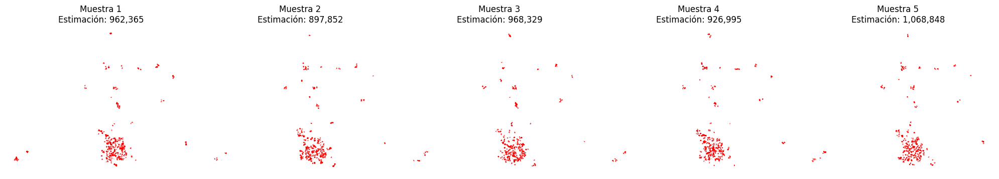

In [24]:
# Ejemplo de uso (descomentar para ejecutar)
# Supone que 'gdf' es un GeoDataFrame válido con columna 'POB_TOTAL'
generar_muestras_y_estimar(gdf)